| Converting Continuous variables to Discrete Categorical variables (If applicable) |Hyperparameter GridSearch

In [1]:
import json
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error
from sklearn.ensemble import GradientBoostingRegressor,RandomForestRegressor,AdaBoostRegressor
from sklearn.svm import SVR
from sklearn.preprocessing import PolynomialFeatures
from sklearn.linear_model import Ridge
from sklearn.pipeline import Pipeline
from sklearn.preprocessing import StandardScaler
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
import lightgbm as lgbm

import numpy as np

import pandas as pd
import seaborn as sns
from sklearn.preprocessing import LabelEncoder
import numpy as np
import matplotlib.pyplot as plt
import shap
from sklearn.model_selection import KFold
import matplotlib.colors as mcolors
import matplotlib

c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [2]:
black = mcolors.CSS4_COLORS["black"]
lime = mcolors.CSS4_COLORS["lime"]
aqua = mcolors.CSS4_COLORS["aqua"]
magenta = mcolors.CSS4_COLORS["magenta"]
red = mcolors.CSS4_COLORS["red"]

In [3]:
path = "./data/feature-selection/"
with open(path + "dataset-wo-outliers-shap_fs-3.json", 'r') as f:
    data_fs_3 = json.load(f)

with open(path + "dataset-wo-outliers-shap_fs-4.json", 'r') as f:
    data_fs_4 = json.load(f)

df_fs_3 = pd.DataFrame.from_dict(data_fs_3,orient="columns")
df_fs_4 = pd.DataFrame.from_dict(data_fs_4,orient="columns")

# Feature Encoding 

This sections aims to improve the model's prediction capability by applying different feature encoding techniques, hopefully reducing any noise within observations and boosting performance.

## Many categories in features - few categories

This technique employs feature distribution analysis to reduce the number of categories in categorical features to at most 3 categories. Categories will be transformed to reduce the number of categories in the relevant features

### Many-categories features (Sample)

Let's try reducing only a subset of the selected features to be reduced in terms of the number of categories.

In [4]:
df_few_cats_fs_3 = df_fs_3.copy()
df_few_cats_fs_4 = df_fs_4.copy()
df_few_cats_fs_4_2 = df_fs_4.copy()

In [5]:
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearBuilt"] < 1930, "YearBuilt"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["YearBuilt"] >= 1930) & (df_few_cats_fs_4_2["YearBuilt"] <= 1985), "YearBuilt"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearBuilt"] > 1985, "YearBuilt"] = 3

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearRemodAdd"] < 1960, "YearRemodAdd"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["YearRemodAdd"] >= 1960) & (df_few_cats_fs_4_2["YearRemodAdd"] <= 1985), "YearRemodAdd"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["YearRemodAdd"] > 1985, "YearRemodAdd"] = 3

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["TotalBsmtSF"] < 250, "TotalBsmtSF"] = 0
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["TotalBsmtSF"] >= 250) & (df_few_cats_fs_4_2["TotalBsmtSF"] <= 2250), "TotalBsmtSF"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["TotalBsmtSF"] > 2250, "TotalBsmtSF"] = 2

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["OverallCond"] < 4.1, "OverallCond"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["OverallCond"] >= 4.1) & (df_few_cats_fs_4_2["OverallCond"] <= 5.8), "OverallCond"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["OverallCond"] > 5.8, "OverallCond"] = 3


#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["GarageType_enc"] < 3, "GarageType_enc"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["GarageType_enc"] >=3, "GarageType_enc"] = 2


#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinSF1"] < 250, "BsmtFinSF1"] = 0
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinSF1"] >=250, "BsmtFinSF1"] = 1

#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["LotArea"] < 25000, "LotArea"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["LotArea"] >=25000, "LotArea"] = 2



#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["ExterQual_enc"] < 1.5, "ExterQual_enc"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["ExterQual_enc"] >= 1.5) & (df_few_cats_fs_4_2["ExterQual_enc"] <= 2.5), "ExterQual_enc"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["ExterQual_enc"] > 2.5, "ExterQual_enc"] = 3



#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinType1_enc"] < 1, "BsmtFinType1_enc"] = 0
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["BsmtFinType1_enc"] >= 1) & (df_few_cats_fs_4_2["BsmtFinType1_enc"] <= 4), "BsmtFinType1_enc"] = 1
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["BsmtFinType1_enc"] > 4, "BsmtFinType1_enc"] = 2


#--------------------

df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["Neighborhood_enc"] < 7, "Neighborhood_enc"] = 1
df_few_cats_fs_4_2.loc[(df_few_cats_fs_4_2["Neighborhood_enc"] >= 7) & (df_few_cats_fs_4_2["Neighborhood_enc"] <= 12.5), "Neighborhood_enc"] = 2
df_few_cats_fs_4_2.loc[df_few_cats_fs_4_2["Neighborhood_enc"] > 12.5, "Neighborhood_enc"] = 3



In [6]:

X_few_cats_fs_4_2 = df_few_cats_fs_4_2.drop(["SalePrice"],axis = 1)
y_few_cats_fs_4_2 = df_few_cats_fs_4_2["SalePrice"]

test_size = 0.25
random_state = 43


X_train_few_cats_fs_4_2,X_valid_few_cats_fs_4_2,y_train_few_cats_fs_4_2, y_valid_few_cats_fs_4_2 = train_test_split(
    X_few_cats_fs_4_2.to_numpy(),y_few_cats_fs_4_2.to_numpy(),test_size=test_size,random_state=random_state)




y_train_few_cats_fs_4_2 = y_train_few_cats_fs_4_2.reshape(-1,1)
y_valid_few_cats_fs_4_2 = y_valid_few_cats_fs_4_2.reshape(-1,1)



#Normalize train shap_1 - Shapley Feature Selection

scaler_X_few_cats_fs_4_2 = StandardScaler().fit(X_train_few_cats_fs_4_2)

X_train_few_cats_fs_4_2_norm = scaler_X_few_cats_fs_4_2.transform(X_train_few_cats_fs_4_2)
y_train_few_cats_fs_4_2_norm = np.log(y_train_few_cats_fs_4_2)

#normalize validation shap_1, mean and stddev from training distribution

mean_X_train_few_cats_fs_4_2 = scaler_X_few_cats_fs_4_2.mean_.reshape(1,-1).repeat(X_valid_few_cats_fs_4_2.shape[0],axis=0)

X_valid_few_cats_fs_4_2_norm = (X_valid_few_cats_fs_4_2 - mean_X_train_few_cats_fs_4_2) / scaler_X_few_cats_fs_4_2.scale_
y_valid_few_cats_fs_4_2_norm = np.log(y_valid_few_cats_fs_4_2)

In [7]:
n_estimators = 100
loss = "squared_error"
learning_rate = 0.1
max_depth = 4
random_state = 43
verbose = 0
alpha = 1.5
kernel = "poly"
degree = 4


models = {
    "XGB_shap_1" : [xgb.XGBRegressor(n_estimators=n_estimators, max_depth=max_depth, eta=learning_rate, subsample=0.7, colsample_bytree=0.8,
                     verbose=verbose),
                     X_train_few_cats_fs_4_2_norm,y_train_few_cats_fs_4_2_norm,X_valid_few_cats_fs_4_2_norm,
                     y_valid_few_cats_fs_4_2_norm],
    "LGBM_shap_1" : [lgbm.LGBMRegressor(max_depth=max_depth, learning_rate=learning_rate, n_estimators=n_estimators, random_state=random_state,
                       verbose=-1),
                       X_train_few_cats_fs_4_2_norm,y_train_few_cats_fs_4_2_norm,X_valid_few_cats_fs_4_2_norm,
                     y_valid_few_cats_fs_4_2_norm],
    
}

for model_name,model_tup in models.items():
    #train model with training set
    model_tup[0].fit(model_tup[1],model_tup[2])

    #predict output using validation set
    pred = model_tup[0].predict(model_tup[3])

    #find MSE score 
    mse_score = mean_squared_error(model_tup[4],pred)
    print(f"Model : {model_name}, MSE score in validation set : {mse_score}")

Model : XGB_shap_1, MSE score in validation set : 0.01695766945618902
Model : LGBM_shap_1, MSE score in validation set : 0.018851998511590508


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [07:08:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "verbose" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


### Many-categories features (Complete)

Now, we try with the full set of many categories features.

In [8]:
df_few_cats_fs_4 = df_few_cats_fs_4_2.copy()

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["KitchenQual_enc"] < 1.5, "KitchenQual_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["KitchenQual_enc"] >= 1.5) & (df_few_cats_fs_4["KitchenQual_enc"] <= 2.5), "KitchenQual_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["KitchenQual_enc"] > 3.5, "KitchenQual_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["SaleCondition_enc"] < 3.2, "SaleCondition_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["SaleCondition_enc"] >= 3.2) & (df_few_cats_fs_4["SaleCondition_enc"] <= 4.7), "KitchenQual_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["SaleCondition_enc"] > 4.7, "SaleCondition_enc"] = 3

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["GarageYrBlt"] < 1500, "GarageYrBlt"] = 0
df_few_cats_fs_4.loc[df_few_cats_fs_4["GarageYrBlt"] >= 1500, "GarageYrBlt"] = 1

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["OpenPorchSF"] < 50, "OpenPorchSF"] = 0
df_few_cats_fs_4.loc[df_few_cats_fs_4["OpenPorchSF"] >= 50, "OpenPorchSF"] = 1


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["MSZoning_enc"] < 2.5, "MSZoning_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["MSZoning_enc"] >= 2.5) & (df_few_cats_fs_4["MSZoning_enc"] <= 3.5), "MSZoning_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["MSZoning_enc"] > 3.5, "MSZoning_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["WoodDeckSF"] < 85, "WoodDeckSF"] = 0
df_few_cats_fs_4.loc[df_few_cats_fs_4["WoodDeckSF"] >= 85, "WoodDeckSF"] = 1


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["Exterior1st_enc"] < 5.2, "Exterior1st_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["Exterior1st_enc"] >= 5.2) & (df_few_cats_fs_4["Exterior1st_enc"] <= 10), "Exterior1st_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["Exterior1st_enc"] > 10, "Exterior1st_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtQual_enc"] < 1.5, "BsmtQual_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["BsmtQual_enc"] >= 1.5) & (df_few_cats_fs_4["BsmtQual_enc"] <= 3), "BsmtQual_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtQual_enc"] > 3, "BsmtQual_enc"] = 3


#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtExposure_enc"] < 2.5, "BsmtExposure_enc"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["BsmtExposure_enc"] >= 2.5) & (df_few_cats_fs_4["BsmtExposure_enc"] <= 3.5), "BsmtExposure_enc"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["BsmtExposure_enc"] > 3.5, "BsmtExposure_enc"] = 3

#--------------------

df_few_cats_fs_4.loc[df_few_cats_fs_4["LotFrontage"] < 60, "LotFrontage"] = 1
df_few_cats_fs_4.loc[(df_few_cats_fs_4["LotFrontage"] >= 60) & (df_few_cats_fs_4["LotFrontage"] <= 80), "LotFrontage"] = 2
df_few_cats_fs_4.loc[df_few_cats_fs_4["LotFrontage"] > 80, "LotFrontage"] = 3

In [9]:
X_few_cats_fs_4 = df_few_cats_fs_4.drop(["SalePrice"],axis = 1)
y_few_cats_fs_4 = df_few_cats_fs_4["SalePrice"]

test_size = 0.25
random_state = 43


X_train_few_cats_fs_4,X_valid_few_cats_fs_4,y_train_few_cats_fs_4, y_valid_few_cats_fs_4 = train_test_split(
    X_few_cats_fs_4.to_numpy(),y_few_cats_fs_4.to_numpy(),test_size=test_size,random_state=random_state)




y_train_few_cats_fs_4 = y_train_few_cats_fs_4.reshape(-1,1)
y_valid_few_cats_fs_4 = y_valid_few_cats_fs_4.reshape(-1,1)



#Normalize train shap_1 - Shapley Feature Selection

scaler_X_few_cats_fs_4 = StandardScaler().fit(X_train_few_cats_fs_4)

X_train_few_cats_fs_4_norm = scaler_X_few_cats_fs_4.transform(X_train_few_cats_fs_4)
y_train_few_cats_fs_4_norm = np.log(y_train_few_cats_fs_4)

#normalize validation shap_1, mean and stddev from training distribution

mean_X_train_few_cats_fs_4 = scaler_X_few_cats_fs_4.mean_.reshape(1,-1).repeat(X_valid_few_cats_fs_4.shape[0],axis=0)

X_valid_few_cats_fs_4_norm = (X_valid_few_cats_fs_4 - mean_X_train_few_cats_fs_4) / scaler_X_few_cats_fs_4.scale_
y_valid_few_cats_fs_4_norm = np.log(y_valid_few_cats_fs_4)

In [10]:
n_estimators = 100
loss = "squared_error"
learning_rate = 0.1
max_depth = 4
random_state = 43
verbose = 0
alpha = 1.5
kernel = "poly"
degree = 4


models = {
    "XGB_shap_1" : [xgb.XGBRegressor(n_estimators=n_estimators, max_depth=max_depth, eta=learning_rate, subsample=0.7, colsample_bytree=0.8,
                     verbose=verbose),
                     X_train_few_cats_fs_4_norm,y_train_few_cats_fs_4_norm,X_valid_few_cats_fs_4_norm,
                     y_valid_few_cats_fs_4_norm],
    "LGBM_shap_1" : [lgbm.LGBMRegressor(max_depth=max_depth, learning_rate=learning_rate, n_estimators=n_estimators, random_state=random_state,
                       verbose=-1),
                       X_train_few_cats_fs_4_norm,y_train_few_cats_fs_4_norm,X_valid_few_cats_fs_4_norm,
                     y_valid_few_cats_fs_4_norm],
    
}

for model_name,model_tup in models.items():
    #train model with training set
    model_tup[0].fit(model_tup[1],model_tup[2])

    #predict output using validation set
    pred = model_tup[0].predict(model_tup[3])

    #find MSE score 
    mse_score = mean_squared_error(model_tup[4],pred)
    print(f"Model : {model_name}, MSE score in validation set : {mse_score}")

Model : XGB_shap_1, MSE score in validation set : 0.017593187996005198
Model : LGBM_shap_1, MSE score in validation set : 0.01861952686793827


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [07:08:01] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "verbose" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


<table>
    <thead>
        <tr>
            <th></th>
            <th colspan = 2><center>Metric: Mean Squared Error (MSE) </center></th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td ><center>ML Model</center></td>
            <td ><center>XGBRegressor</center></td>
            <td><center>LightGBMRegressor</center></td>
        </tr>
        <tr>
            <td><center>Baseline Dataset Norm Ln(y)</center></td>
            <td><center><span style="text-decoration: underline;">0.01577</span></center></td>
            <td><center><span style="text-decoration: underline;">0.01605</span></center></td>
        </tr>
        <tr>
            <td><center>Shap Model 3</center></td>
            <td><center>0.0159</center></td>
            <td><center><strong>0.01562</strong></center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4</center></td>
            <td><center><strong>0.015552</strong></center></td>
            <td><center>0.0163</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4 - Sample Feature Encoding</center></td>
            <td><center>0.01695</center></td>
            <td><center>0.01885</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4 - Complete Feature Encoding</center></td>
            <td><center>0.01759</center></td>
            <td><center>0.01861</center></td>
        </tr>
    </tbody>
</table>

Conclusion: This approach for improving Model's predicting capability was not useful, we discard these data processing steps for the dataset.

## One-Hot Encoding

This approach consists on one-hot encoding categorical variables to see if any improvement in model's performance arises.

In [11]:
df_one_hot_fs_3 = df_fs_3.copy()
df_one_hot_fs_4 = df_fs_4.copy()

In [12]:
df_one_hot_fs_4.select_dtypes(["int64"]).columns.drop(["SalePrice"])

Index(['OverallQual', 'GrLivArea', 'GarageCars', 'YearBuilt', 'YearRemodAdd',
       'TotalBsmtSF', 'OverallCond', 'GarageType_enc', 'BsmtFinSF1', 'LotArea',
       'ExterQual_enc', 'GarageArea', '1stFlrSF', 'BsmtFinType1_enc',
       'Neighborhood_enc', 'Fireplaces', 'KitchenQual_enc',
       'SaleCondition_enc', 'CentralAir_enc', 'OpenPorchSF', 'MSZoning_enc',
       'WoodDeckSF', 'Exterior1st_enc', 'BsmtQual_enc', 'BsmtExposure_enc'],
      dtype='object')

In [13]:
df_one_hot_fs_4[['OverallQual']].value_counts()

OverallQual
5              373
6              325
7              288
8              126
4              104
9               24
3               19
10               8
2                3
1                2
Name: count, dtype: int64

In [14]:
df_one_hot_fs_4[['GarageCars']].value_counts()

GarageCars
2             726
1             344
3             124
0              73
4               5
Name: count, dtype: int64

In [15]:
pd.get_dummies(df_one_hot_fs_4[['OverallQual', 'GarageCars']].astype("category"),prefix=None,dtype=float)

,OverallQual_1,OverallQual_2,OverallQual_3,OverallQual_4,OverallQual_5,OverallQual_6,OverallQual_7,OverallQual_8,OverallQual_9,OverallQual_10,GarageCars_0,GarageCars_1,GarageCars_2,GarageCars_3,GarageCars_4
0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
2,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
3,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
4,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1267,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1268,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0
1269,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
1270,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0


In [16]:
df_one_hot_fs_4.select_dtypes(["int64"]).shape

(1272, 26)

In [17]:
df_one_hot_fs_4.select_dtypes(["float"]).shape

(1272, 2)

In [18]:
df_one_hot_fs_4.shape

(1272, 28)

In [19]:
df_one_hot_encode_fs_4 = pd.get_dummies(df_one_hot_fs_4.select_dtypes(["int64"]).drop(["SalePrice"],axis=1).astype("category"),dtype=float)
df_one_hot_encode_fs_4 = pd.concat([df_one_hot_encode_fs_4,df_one_hot_fs_4.select_dtypes(["float"]),df_one_hot_fs_4["SalePrice"]],axis=1)

In [20]:
X_one_hot_encode_fs_4 = df_one_hot_encode_fs_4.drop(["SalePrice"],axis = 1)
y_one_hot_encode_fs_4 = df_one_hot_encode_fs_4["SalePrice"]

test_size = 0.25
random_state = 43


X_train_one_hot_encode_fs_4,X_valid_one_hot_encode_fs_4,y_train_one_hot_encode_fs_4, y_valid_one_hot_encode_fs_4 = train_test_split(
    X_one_hot_encode_fs_4.to_numpy(),y_one_hot_encode_fs_4.to_numpy(),test_size=test_size,random_state=random_state)




y_train_one_hot_encode_fs_4 = y_train_one_hot_encode_fs_4.reshape(-1,1)
y_valid_one_hot_encode_fs_4 = y_valid_one_hot_encode_fs_4.reshape(-1,1)



#Normalize train shap_1 - Shapley Feature Selection

scaler_X_one_hot_encode_fs_4 = StandardScaler().fit(X_train_one_hot_encode_fs_4)

X_train_one_hot_encode_fs_4_norm = scaler_X_one_hot_encode_fs_4.transform(X_train_one_hot_encode_fs_4)
y_train_one_hot_encode_fs_4_norm = np.log(y_train_one_hot_encode_fs_4)

#normalize validation shap_1, mean and stddev from training distribution

mean_X_train_one_hot_encode_fs_4 = scaler_X_one_hot_encode_fs_4.mean_.reshape(1,-1).repeat(X_valid_one_hot_encode_fs_4.shape[0],axis=0)

X_valid_one_hot_encode_fs_4_norm = (X_valid_one_hot_encode_fs_4 - mean_X_train_one_hot_encode_fs_4) / scaler_X_one_hot_encode_fs_4.scale_
y_valid_one_hot_encode_fs_4_norm = np.log(y_valid_one_hot_encode_fs_4)

In [21]:
n_estimators = 100
loss = "squared_error"
learning_rate = 0.1
max_depth = 4
random_state = 43
verbose = 0
alpha = 1.5
kernel = "poly"
degree = 4

tree_estimator = DecisionTreeRegressor(criterion=loss,max_depth=max_depth,random_state=random_state)

models = {
    "XGB_one_hot" : [xgb.XGBRegressor(n_estimators=n_estimators, max_depth=max_depth, eta=learning_rate, subsample=0.7, colsample_bytree=0.8,
                     verbose=verbose),
                     X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "LGBM_one_hot" : [lgbm.LGBMRegressor(max_depth=max_depth, learning_rate=learning_rate, n_estimators=n_estimators, random_state=random_state,
                       verbose=-1),
                       X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],    
    #"ridge_one_hot": [Pipeline([('poly', PolynomialFeatures(degree=degree)),
    #              ('ridge', Ridge(alpha=alpha, random_state=random_state))]),
    #              X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
    #                 y_valid_one_hot_encode_fs_4_norm],
    "SVM_one_hot": [SVR(kernel=kernel,degree=degree, C= alpha),
         X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "Grad_Boost_one_hot":[GradientBoostingRegressor(n_estimators=n_estimators, loss=loss, learning_rate=learning_rate, max_depth=max_depth,
                                                    random_state=random_state,
                              verbose=verbose),
                              X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "RandomForest_one_hot": [RandomForestRegressor(n_estimators=n_estimators,criterion=loss,max_depth=max_depth,random_state=random_state,
                          verbose=verbose),
                          X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm],
    "Adaboost_one_hot" : [AdaBoostRegressor(estimator=tree_estimator,n_estimators=n_estimators,learning_rate=learning_rate,loss="square",
                                            random_state=random_state),
                                            X_train_one_hot_encode_fs_4_norm,y_train_one_hot_encode_fs_4_norm,X_valid_one_hot_encode_fs_4_norm,
                     y_valid_one_hot_encode_fs_4_norm]
    
}

for model_name,model_tup in models.items():
    #train model with training set
    model_tup[0].fit(model_tup[1],model_tup[2])

    #predict output using validation set
    pred = model_tup[0].predict(model_tup[3])

    #find MSE score 
    mse_score = mean_squared_error(model_tup[4],pred)
    print(f"Model : {model_name}, MSE score in validation set : {mse_score}")


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [07:08:02] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "verbose" } are not used.

  warnings.warn(smsg, UserWarning)


Model : XGB_one_hot, MSE score in validation set : 0.02698230602255613
Model : LGBM_one_hot, MSE score in validation set : 0.028847269321232497


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model : SVM_one_hot, MSE score in validation set : 0.13783191755352062


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\ensemble\_gb.py:668: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)  # TODO: Is this still required?


Model : Grad_Boost_one_hot, MSE score in validation set : 0.02774110669793772


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\base.py:1473: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples,), for example using ravel().
  return fit_method(estimator, *args, **kwargs)


Model : RandomForest_one_hot, MSE score in validation set : 0.043245979152531526


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\sklearn\utils\validation.py:1339: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


Model : Adaboost_one_hot, MSE score in validation set : 0.037864618802740516


<table>
    <thead>
        <tr>
            <th></th>
            <th colspan = 6><center>Metric: Mean Squared Error (MSE) </center></th>
        </tr>
    </thead>
    <tbody>
        <tr>
            <td ><center>ML Model</center></td>
            <td ><center>XGBRegressor</center></td>
            <td><center>LightGBMRegressor</center></td>
            <td><center>SVM</center></td>
            <td><center>Gradient Boosting</center></td>
            <td><center>Random Forest</center></td>
            <td><center>AdaBoost</center></td>
        </tr>
        <tr>
            <td><center>Baseline Dataset Norm Ln(y)</center></td>
            <td><center><span style="text-decoration: underline;">0.01577</span></center></td>
            <td><center><span style="text-decoration: underline;">0.01605</span></center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 3</center></td>
            <td><center>0.0159</center></td>
            <td><center><strong>0.01562</strong></center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
        </tr>
        <tr>
            <td><center>Shap Model 4</center></td>
            <td><center><strong>0.015552</strong></center></td>
            <td><center>0.0163</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
            <td><center>-</center></td>
        </tr>
        <tr>
            <td><center>One-Hot Encode </center></td>
            <td><center>0.0269</center></td>
            <td><center>0.028</center></td>
            <td><center>0.137</center></td>
            <td><center>0.0277</center></td>
            <td><center>0.0432</center></td>
            <td><center>0.0378</center></td>
        </tr>
    </tbody>
</table>

Conclusion: One-hot encoding did not improve the previous results. We discard these datasets for future experiments

# Hyperparameter GridSearch

Shapley feature selection dataframe 3 - Normalization Dataset

In [22]:
# Dataframe to Numpy array Dataset

X_df_fs_3 = df_fs_3.drop(["SalePrice"],axis = 1)
y_df_fs_3 = df_fs_3["SalePrice"]

test_size = 0.25
random_state = 43


X_train_fs_3,X_valid_fs_3,y_train_fs_3, y_valid_fs_3 = train_test_split(
    X_df_fs_3.to_numpy(),y_df_fs_3.to_numpy(),test_size=test_size,random_state=random_state)


y_train_fs_3 = y_train_fs_3.reshape(-1,1)
y_valid_fs_3 = y_valid_fs_3.reshape(-1,1)



#Normalize train FS 3

scaler_X_fs_3 = StandardScaler().fit(X_train_fs_3)

X_train_fs_3_norm = scaler_X_fs_3.transform(X_train_fs_3)
y_train_fs_3_norm = np.log(y_train_fs_3)

#normalize validation FS 3, mean and stddev from training distribution

mean_X_train_fs_3 = scaler_X_fs_3.mean_.reshape(1,-1).repeat(X_valid_fs_3.shape[0],axis=0)

X_valid_fs_3_norm = (X_valid_fs_3 - mean_X_train_fs_3) / scaler_X_fs_3.scale_
y_valid_fs_3_norm = np.log(y_valid_fs_3)

#-------------------------------------------------------------------------------------------------------------

Shapley feature selection dataframe 4 - Normalization Dataset

In [23]:
# Dataframe to Numpy array Dataset

X_df_fs_4 = df_fs_4.drop(["SalePrice"],axis = 1)
y_df_fs_4 = df_fs_4["SalePrice"]

X_train_fs_4,X_valid_fs_4,y_train_fs_4, y_valid_fs_4 = train_test_split(
    X_df_fs_4.to_numpy(),y_df_fs_4.to_numpy(),test_size=test_size,random_state=random_state)


y_train_fs_4 = y_train_fs_4.reshape(-1,1)
y_valid_fs_4 = y_valid_fs_4.reshape(-1,1)



#Normalize train FS 4

scaler_X_fs_4 = StandardScaler().fit(X_train_fs_4)

X_train_fs_4_norm = scaler_X_fs_4.transform(X_train_fs_4)
y_train_fs_4_norm = np.log(y_train_fs_4)

#normalize validation FS 4, mean and stddev from training distribution

mean_X_train_fs_4 = scaler_X_fs_4.mean_.reshape(1,-1).repeat(X_valid_fs_4.shape[0],axis=0)

X_valid_fs_4_norm = (X_valid_fs_4 - mean_X_train_fs_4) / scaler_X_fs_4.scale_
y_valid_fs_4_norm = np.log(y_valid_fs_4)

#-------------------------------------------------------------------------------------------------------------

## XGBRegressor Hyperparameter Tuning

Shapley dataframe 3 - XGBRegressor

In [24]:
param_grid={
    'n_estimators':[100,500,900,1000,1100,1500],
    'eta':[0.05,0.08,0.1,0.15],
    'booster':['gbtree','gblinear'],
    'max_depth':[3,5,10],
    'min_child_weight':[1,2],
    "gamma" : [0.001,0.01,0.1,0.2],
    "subsample" : [0.5,1],
    "colsample_bytree" : [0.5,1],
    "lambda" : [1,2,3],
    "alpha" : [0,0.5,1]
}

In [25]:
""" 
model_xgb_fs_3 = xgb.XGBRegressor(seed=random_state)

gs_xgb_fs_3 = GridSearchCV(model_xgb_fs_3,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
gs_xgb_fs_3.fit(X_train_fs_3_norm,y_train_fs_3_norm)

pred = gs_xgb_fs_3.predict(X_valid_fs_3_norm)

mse_score = mean_squared_error(y_valid_fs_3_norm,pred)
print(f"Model : {model_xgb_fs_3.__class__}, MSE score in validation set : {mse_score}") """

' \nmodel_xgb_fs_3 = xgb.XGBRegressor(seed=random_state)\n\ngs_xgb_fs_3 = GridSearchCV(model_xgb_fs_3,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")\ngs_xgb_fs_3.fit(X_train_fs_3_norm,y_train_fs_3_norm)\n\npred = gs_xgb_fs_3.predict(X_valid_fs_3_norm)\n\nmse_score = mean_squared_error(y_valid_fs_3_norm,pred)\nprint(f"Model : {model_xgb_fs_3.__class__}, MSE score in validation set : {mse_score}") '

Shapley dataframe 4 - XGBRegressor

In [26]:
param_grid={
    'n_estimators':[100,500,900,1000,1100,1500],
    'eta':[0.05,0.08,0.1,0.15],
    'booster':['gbtree','gblinear'],
}

In [27]:
n_estimators = [100,500]#,900,1000,1100,1500]
eta = [0.05,0.08]#,0.1,0.15]
booster = ['gbtree','gblinear']


In [28]:
kf= KFold(n_splits=5,random_state=43,shuffle=True)

In [29]:
for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):
    print(f"Fold {i}:")
    print(f"  Train: index={train_index[:10]}")
    print(f"  Test:  index={test_index[:10]}")
    

Fold 0:
  Train: index=[ 0  2  3  4  5  6  7  8  9 10]
  Test:  index=[ 1 11 15 17 24 27 29 34 36 47]
Fold 1:
  Train: index=[ 1  2  3  4  5  6  7  8 10 11]
  Test:  index=[ 0  9 12 19 21 35 38 49 61 63]
Fold 2:
  Train: index=[ 0  1  5  6  7  8  9 10 11 12]
  Test:  index=[ 2  3  4 18 20 31 41 42 44 45]
Fold 3:
  Train: index=[ 0  1  2  3  4  5  7  9 11 12]
  Test:  index=[ 6  8 10 13 14 22 25 26 28 30]
Fold 4:
  Train: index=[ 0  1  2  3  4  6  8  9 10 11]
  Test:  index=[ 5  7 16 23 32 33 40 46 51 52]


In [30]:
ls = [(5,10),(2,4),(1,3)]
t = sorted(
    ls, 
    key=lambda x: x[1],
    reverse=False
)

In [31]:
ls = [1,3,4]
np.argmax(ls)

np.int64(2)

In [32]:
""" best_model_score = 100.0
best_model = None


for n_est in n_estimators:
    for lr in eta:
        for boost in booster:

            ls_candidate_models = []
            ls_candidate_scores = []

            
            for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):
                kf_X_train, kf_y_train, kf_X_test, kf_y_test = X_train_fs_4_norm[train_index],y_train_fs_4_norm[train_index], X_train_fs_4_norm[test_index],y_train_fs_4_norm[test_index]
                
                #set model
                model = xgb.XGBRegressor(
                n_estimators=n_est,eta=lr,booster=boost, seed=random_state)

                model.fit(kf_X_train,kf_y_train)

                y_pred =model.predict(kf_X_test)

                mse_score_k = mean_squared_error(kf_y_test,y_pred)

                ls_candidate_models.append(model)
                ls_candidate_scores.append(mse_score_k)


                #print(f"Estimators : {n_est}, lr : {lr}, booster : {boost}, CV: {i+1}, MSE test score : {mse_score_k}")

            if np.average(ls_candidate_scores) < best_model_score:
                print(f"past best model score  : {best_model_score}, avg new best : {np.average(ls_candidate_scores)}")
                idx_best = np.argmax(ls_candidate_scores)
                best_model = ls_candidate_models[idx_best]
                print(f"new best indv score: {np.max(ls_candidate_scores)}")
                best_model_score = np.average(ls_candidate_scores)
 """

' best_model_score = 100.0\nbest_model = None\n\n\nfor n_est in n_estimators:\n    for lr in eta:\n        for boost in booster:\n\n            ls_candidate_models = []\n            ls_candidate_scores = []\n\n            \n            for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):\n                kf_X_train, kf_y_train, kf_X_test, kf_y_test = X_train_fs_4_norm[train_index],y_train_fs_4_norm[train_index], X_train_fs_4_norm[test_index],y_train_fs_4_norm[test_index]\n                \n                #set model\n                model = xgb.XGBRegressor(\n                n_estimators=n_est,eta=lr,booster=boost, seed=random_state)\n\n                model.fit(kf_X_train,kf_y_train)\n\n                y_pred =model.predict(kf_X_test)\n\n                mse_score_k = mean_squared_error(kf_y_test,y_pred)\n\n                ls_candidate_models.append(model)\n                ls_candidate_scores.append(mse_score_k)\n\n\n                #print(f"Estimators : {n_est},

In [33]:
best_model = None
best_model_score = 100.0

In [34]:
""" for n_est in n_estimators:
    for lr in eta:
        for boost in booster:
            #set model
            """ model = xgb.XGBRegressor(
                n_estimators=n_est,eta=lr,booster=boost, seed=random_state) """
            for i, (train_index, test_index) in enumerate(kf.split(X_train_fs_4_norm)):
                kf_X_train, kf_y_train, kf_X_test, kf_y_test = X_train_fs_4_norm[train_index],y_train_fs_4_norm[train_index], X_train_fs_4_norm[test_index],y_train_fs_4_norm[test_index]
                
                model = xgb.XGBRegressor(
                n_estimators=n_est,eta=lr,booster=boost, seed=random_state)
                model.fit(kf_X_train,kf_y_train)

                y_pred =model.predict(kf_X_test)

                mse_score_k = mean_squared_error(kf_y_test,y_pred)

                #print(f"Estimators : {n_est}, lr : {lr}, booster : {boost}, CV: {i+1}, MSE test score : {mse_score_k}")

            if mse_score_k < best_model_score:
                best_model = model
 """

SyntaxError: invalid syntax (1363427548.py, line 5)

In [ ]:
""" 
model = xgb.XGBRegressor(seed=random_state)

reg = GridSearchCV(model,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
reg.fit(X_train_fs_4_norm,y_train_fs_4_norm)

pred = reg.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}") """

Fitting 5 folds for each of 41472 candidates, totalling 207360 fits


c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:09:28] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:09:28] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci-windows\src\learner.cc:740: 
Parameters: { "colsample_bytree", "gamma", "max_depth", "min_child_weight", "subsample" } are not used.

  warnings.warn(smsg, UserWarning)
c:\Users\kevin\miniconda3\envs\hackerrank\Lib\site-packages\xgboost\core.py:158: UserWarning: [11:09:28] WARNING: C:\buildkite-agent\builds\buildkite-windows-cpu-autoscaling-group-i-0015a694724fa8361-1\xgboost\xgboost-ci

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.014710830657054847


In [ ]:

model_xgb_fs_4 = model

gs_xgb_fs_4 = reg
#gs_xgb_fs_4.fit(X_train_fs_4_norm,y_train_fs_4_norm)

pred = gs_xgb_fs_4.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model_xgb_fs_4.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.014710830657054847


In [ ]:
gs_xgb_fs_4.best_estimator_.get_params()["alpha"]

0

'n_estimators':[100,500,900,1000,1100,1500], 1100
    'eta':[0.05,0.08,0.1,0.15],   0.05
    'booster':['gbtree','gblinear'],   gbtree
    'max_depth':[3,5,10],     3
    'min_child_weight':[1,2],  1
    "gamma" : [0.001,0.01,0.1,0.2], .001  
    "subsample" : [0.5,1],   0.5
    "colsample_bytree" : [0.5,1],   0.5
    "lambda" : [1,2,3],     1
    "alpha" : [0,0.5,1]       0

In [ ]:
pred = best_model.predict(X_valid_fs_4_norm) #based on avg model cv preiction

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.015191560155207876


In [ ]:
pred = best_model.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.015188425992898071


In [ ]:
pred = reg.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model.__class__}, MSE score in validation set : {mse_score}")

Model : <class 'xgboost.sklearn.XGBRegressor'>, MSE score in validation set : 0.015124262501459255


In [ ]:
reg.best_estimator_.get_params()

100

In [ ]:
reg.cv_results_["mean_test_score"]



array([-0.02002368, -0.01950986, -0.01951297, -0.01951297, -0.01951297,
       -0.01951297, -0.01991346, -0.0198042 , -0.0198042 , -0.0198042 ,
       -0.0198042 , -0.0198042 , -0.01925011, -0.01926   , -0.01926   ,
       -0.01926   , -0.01926   , -0.01926   , -0.0198129 , -0.01980298,
       -0.01980298, -0.01980298, -0.01980298, -0.01980298, -0.01587497,
       -0.01566057, -0.01566927, -0.0156698 , -0.01567012, -0.01567059,
       -0.01569419, -0.01566829, -0.01567059, -0.01567063, -0.01567066,
       -0.01567071, -0.01566772, -0.01567002, -0.01567068, -0.0156707 ,
       -0.01567067, -0.01567069, -0.01565   , -0.01567066, -0.01567069,
       -0.0156707 , -0.0156707 , -0.0156707 ])

In [ ]:
reg.cv_results_["rank_test_score"]

array([48, 31, 32, 32, 32, 32, 47, 41, 41, 41, 41, 41, 25, 26, 26, 26, 26,
       26, 46, 36, 36, 36, 36, 36, 24,  2,  5,  6,  8, 10, 23,  4,  9, 11,
       13, 22,  3,  7, 15, 19, 14, 17,  1, 12, 16, 18, 20, 21],
      dtype=int32)

## LightGBM Hyperparameter Tuning

Shapley dataframe 3 - LightGBMRegressor

In [ ]:
param_grid={
    'n_estimators':[100,500,900,1000,1100,1500],
    'learning_rate':[0.01,0.03,0.09,0.13],
    'max_depth':[3,5,10],
    "num_leaves" : [10,31,50],
    "min_data_in_leaf" : [20,30,50],
    "feature_fraction" : [0.5,1.0],
    "bagging_freq" : [0.5],
    "bagging_fraction" : [0.3,0.75],
    "lamda_l1" : [0.0,1.0,2.0],
    "lambda_l2" : [0.0,1.0,2.0]
}

In [ ]:

model_lgbm_fs_3 = lgbm.LGBMRegressor(random_state=random_state,verbose=-1)

gs_lgbm_fs_3 = GridSearchCV(model_lgbm_fs_3,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
gs_lgbm_fs_3.fit(X_train_fs_3_norm,y_train_fs_3_norm)

pred = gs_lgbm_fs_3.predict(X_valid_fs_3_norm)

mse_score = mean_squared_error(y_valid_fs_3_norm,pred)
print(f"Model : {model_lgbm_fs_3.__class__}, MSE score in validation set : {mse_score}")

Shapley dataframe 4 - LightGBMRegressor

In [ ]:

model_lgbm_fs_4 = lgbm.LGBMRegressor(random_state=random_state,verbose=-1)

gs_lgbm_fs_4 = GridSearchCV(model_lgbm_fs_4,param_grid,verbose=1,cv=5,scoring="neg_mean_squared_error")
gs_lgbm_fs_4.fit(X_train_fs_4_norm,y_train_fs_4_norm)

pred = gs_lgbm_fs_4.predict(X_valid_fs_4_norm)

mse_score = mean_squared_error(y_valid_fs_4_norm,pred)
print(f"Model : {model_lgbm_fs_4.__class__}, MSE score in validation set : {mse_score}")

# Submission

## Process Test Dataset according to previous Data Cleaning approach

In [ ]:
test_df = pd.read_csv("data/test.csv")

In [ ]:
test_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1459 entries, 0 to 1458
Data columns (total 80 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   Id             1459 non-null   int64  
 1   MSSubClass     1459 non-null   int64  
 2   MSZoning       1455 non-null   object 
 3   LotFrontage    1232 non-null   float64
 4   LotArea        1459 non-null   int64  
 5   Street         1459 non-null   object 
 6   Alley          107 non-null    object 
 7   LotShape       1459 non-null   object 
 8   LandContour    1459 non-null   object 
 9   Utilities      1457 non-null   object 
 10  LotConfig      1459 non-null   object 
 11  LandSlope      1459 non-null   object 
 12  Neighborhood   1459 non-null   object 
 13  Condition1     1459 non-null   object 
 14  Condition2     1459 non-null   object 
 15  BldgType       1459 non-null   object 
 16  HouseStyle     1459 non-null   object 
 17  OverallQual    1459 non-null   int64  
 18  OverallC

In [ ]:
def preprocess_test_df(df,df_type = 3):

    # String features label encoding

    #--------------------------

    new_feat_col_names = []

    for col_name in test_df.select_dtypes(["object"]).columns.values:
        new_feat_name = col_name + "_enc"
        x = LabelEncoder().fit_transform(df[col_name])
        temp_serie = pd.Series(x,name=new_feat_name)
        df = pd.concat([df,temp_serie],axis=1)
        df.drop([col_name],axis = 1,inplace=True)
        new_feat_col_names.append(new_feat_name)


    float_features = df.columns.drop(new_feat_col_names).tolist()
    df = df[new_feat_col_names + float_features]

    #keep relevant features according to the feature selection process
    shap_feat_names = ["OverallQual","GrLivArea","GarageCars","YearBuilt","YearRemodAdd","TotalBsmtSF","OverallCond","GarageType_enc",
                       "BsmtFinSF1","LotArea","ExterQual_enc","GarageArea","1stFlrSF","BsmtFinType1_enc","Neighborhood_enc", "Fireplaces", 
                       "KitchenQual_enc","SaleCondition_enc","GarageYrBlt"]
    if df_type == 4:
        shap_feat_names = shap_feat_names + ["CentralAir_enc","OpenPorchSF","MSZoning_enc","WoodDeckSF","Exterior1st_enc","BsmtQual_enc",
                                             "BsmtExposure_enc","LotFrontage"]
        
    return df[shap_feat_names]



In [ ]:
fs_4_test_df = preprocess_test_df(test_df.copy(),4)

In [ ]:
fs_4_test_df.isnull().sum()

OverallQual            0
GrLivArea              0
GarageCars             1
YearBuilt              0
YearRemodAdd           0
TotalBsmtSF            1
OverallCond            0
GarageType_enc         0
BsmtFinSF1             1
LotArea                0
ExterQual_enc          0
GarageArea             1
1stFlrSF               0
BsmtFinType1_enc       0
Neighborhood_enc       0
Fireplaces             0
KitchenQual_enc        0
SaleCondition_enc      0
GarageYrBlt           78
CentralAir_enc         0
OpenPorchSF            0
MSZoning_enc           0
WoodDeckSF             0
Exterior1st_enc        0
BsmtQual_enc           0
BsmtExposure_enc       0
LotFrontage          227
dtype: int64

Let's remove outliers and impute data according to feature's distribution (similar as Notebook One)

In [ ]:
fs_4_test_df[["GarageCars","TotalBsmtSF","BsmtFinSF1","GarageArea"]].describe()

,GarageCars,TotalBsmtSF,BsmtFinSF1,GarageArea
count,1458.000000,1458.000000,1458.000000,1458.000000
mean,1.766118,1046.117970,439.203704,472.768861
std,0.775945,442.898624,455.268042,217.048611
min,0.000000,0.000000,0.000000,0.000000
25%,1.000000,784.000000,0.000000,318.000000
50%,2.000000,988.000000,350.500000,480.000000
75%,2.000000,1305.000000,753.500000,576.000000
max,5.000000,5095.000000,4010.000000,1488.000000


### GarageCars & GarageArea Features

In [ ]:
miss_data_garage = fs_4_test_df[["GarageCars","GarageArea"]].isnull()
miss_data_garage.loc[miss_data_garage["GarageCars"] == True].all(axis=1)

1116    True
dtype: bool

Text(510, 0.001, 'Most freq val')

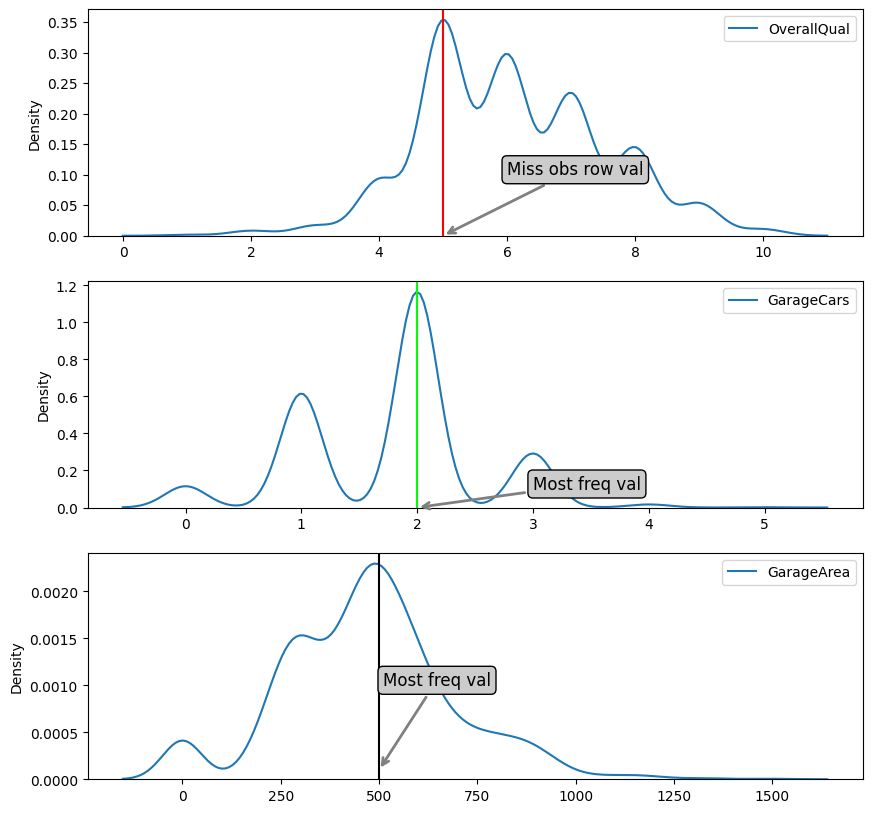

In [ ]:
fig,axes = plt.subplots(3,1,figsize=(10,10))
sns.kdeplot(fs_4_test_df[["OverallQual"]],ax=axes[0])
axes[0].axvline(x = 5,    # Line on x = 2
        ymin = 0, # Bottom of the plot
           ymax = 1,color=red)
axes[0].annotate('Miss obs row val', xy=(5, 0.00010), xytext=(6,0.1), fontsize=12,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox=dict(boxstyle="round", fc="0.8"))
sns.kdeplot(fs_4_test_df[["GarageCars"]],ax=axes[1])
axes[1].axvline(x = 2,    # Line on x = 2
        ymin = 0, # Bottom of the plot
           ymax = 1,color=lime)
axes[1].annotate('Most freq val', xy=(2, 0.00010), xytext=(3,0.1), fontsize=12,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox=dict(boxstyle="round", fc="0.8"))
#--------
sns.kdeplot(fs_4_test_df[["GarageArea"]],ax=axes[2])
axes[2].axvline(x = 500,    # Line on x = 2
        ymin = 0, # Bottom of the plot
           ymax = 1,color=black)
axes[2].annotate('Most freq val', xy=(500, 0.00010), xytext=(510,0.001), fontsize=12,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox=dict(boxstyle="round", fc="0.8"))

Conclusion: GarageCars & GarageArea single row with missing values were plotted previously along with the value for OverQuall. For the row observation where the missing values for both features occur, it corresponds to a OverQuall feature of 5, which is the most frequent value from its distribution. We will aproximate the real missing values following the same strategy, we will impute this row by utilizing the mean of each distribution.

In [ ]:
dict_na = {
    "GarageCars" : fs_4_test_df["GarageCars"].median(),
    "GarageArea" : fs_4_test_df["GarageArea"].mean()
}

fs_4_test_df.fillna(dict_na,inplace=True)


### TotalBsmtSF & BsmtFinSF1

In [ ]:
miss_data_garage = fs_4_test_df[["TotalBsmtSF","BsmtFinSF1"]].isnull()
miss_data_garage.loc[miss_data_garage["TotalBsmtSF"] == True].all(axis=1)

660    True
dtype: bool

Replace with mean from both features

In [ ]:
dict_na = {
    "TotalBsmtSF" : fs_4_test_df["TotalBsmtSF"].mean(),
    "BsmtFinSF1" : fs_4_test_df["BsmtFinSF1"].mean()
}

fs_4_test_df.fillna(dict_na,inplace=True)

### LotFrontage & GarageYrBlt

C:\Users\kevin\AppData\Local\Temp\ipykernel_39300\4006926194.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(fs_4_test_df["LotFrontage"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})


Text(160, 0.002, 'Possible outliers')

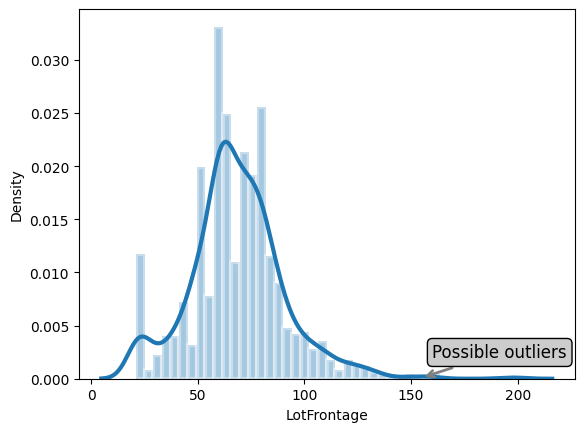

In [ ]:
ax = sns.distplot(fs_4_test_df["LotFrontage"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})

# notation indicating a possible outlier
ax.annotate('Possible outliers', xy=(155, 0.00010), xytext=(160, 0.0020), fontsize=12,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox=dict(boxstyle="round", fc="0.8"))

Text(0.1, 10, 'Outliers')

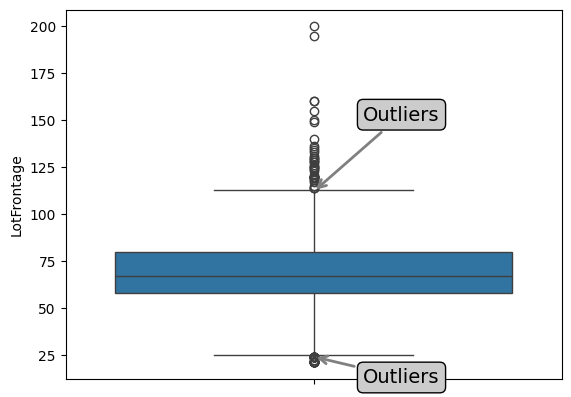

In [ ]:
ax = sns.boxplot(fs_4_test_df["LotFrontage"])

# notation indicating an outlier
ax.annotate('Outliers', xy=(0,112), xytext=(0.1,150), fontsize=14,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox = dict(boxstyle="round", fc="0.8"))

ax.annotate('Outliers', xy=(0,24), xytext=(0.1,10), fontsize=14,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox = dict(boxstyle="round", fc="0.8"))

Find the filling values according to LotFrontage distribution

In [ ]:
fill_values = {
    "LotFrontage" : fs_4_test_df["LotFrontage"][(fs_4_test_df["LotFrontage"] >= 24.0) & (fs_4_test_df["LotFrontage"] >= 112.0)].mean()
}

C:\Users\kevin\AppData\Local\Temp\ipykernel_39300\3201836295.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  ax = sns.distplot(fs_4_test_df["GarageYrBlt"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})


Text(2050, 0.002, 'Possible outliers')

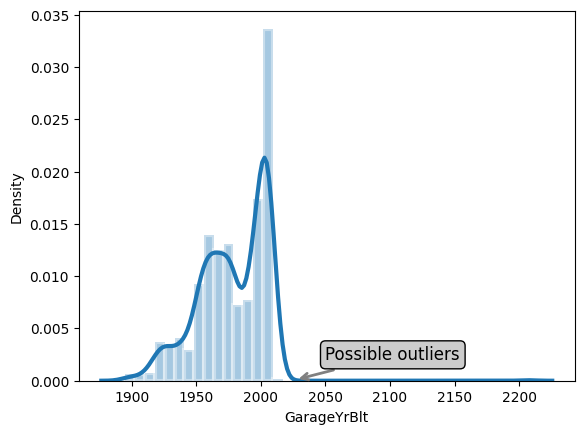

In [ ]:
ax = sns.distplot(fs_4_test_df["GarageYrBlt"], hist=True, hist_kws={"edgecolor": 'w', "linewidth": 3}, kde_kws={"linewidth": 3})

# notation indicating a possible outlier
ax.annotate('Possible outliers', xy=(2027, 0.00010), xytext=(2050, 0.0020), fontsize=12,
            arrowprops=dict(arrowstyle='->', ec='grey', lw=2), bbox=dict(boxstyle="round", fc="0.8"))

Find the filling values according to GarageYrBlt multinomial distribution

In [ ]:
garage_yr_blt_wo_outliers = fs_4_test_df["GarageYrBlt"][(fs_4_test_df["GarageYrBlt"] <= 2027.0)].count()
garage_yr_blt_1 = fs_4_test_df["GarageYrBlt"][(fs_4_test_df["GarageYrBlt"] <= 1975.0)]
garage_yr_blt_1_mean = garage_yr_blt_1.mean() * (garage_yr_blt_1.count() / garage_yr_blt_wo_outliers)

garage_yr_blt_2 = fs_4_test_df["GarageYrBlt"][(fs_4_test_df["GarageYrBlt"] > 1975.0) & (fs_4_test_df["GarageYrBlt"] <= 2027.0)]
garage_yr_blt_2_mean = garage_yr_blt_2.mean() * (garage_yr_blt_2.count() / garage_yr_blt_wo_outliers)

garage_yr_blt_approx = garage_yr_blt_1_mean + garage_yr_blt_2_mean

In [ ]:
fill_values["GarageYrBlt"] = garage_yr_blt_approx

Now, fill the missing values according to feature distributions

In [ ]:
fs_4_test_df.fillna(fill_values,inplace=True)

## Normalize Test Datasets

In [ ]:
# Dataframe to Numpy array Dataset

X_df_fs_4_test = fs_4_test_df.copy().to_numpy()


#Normalize test FS 4

scaler_X_fs_4_test = StandardScaler().fit(X_df_fs_4_test)

X_fs_4_test_norm = scaler_X_fs_4_test.transform(X_df_fs_4_test)


## Predict Datasets

Shapley Feature Selection DF 4 - XGBREGRESSOR

In [ ]:
y_pred_test_fs_4_xgb = gs_xgb_fs_4.predict(X_fs_4_test_norm)

In [ ]:
y_pred_test_fs_4_xgb = np.exp(y_pred_test_fs_4_xgb)

## Save Submission predictions to csv

In [ ]:
path = "./data/submissions/"

In [ ]:
empty_cols = {
    "Id" : np.arange(1461,1461 + fs_4_test_df.shape[0]),
    "SalePrice" : np.zeros([fs_4_test_df.shape[0],],dtype=float)
}

fs_4_test_submission = pd.DataFrame(empty_cols)

In [ ]:
fs_4_test_submission["SalePrice"] = y_pred_test_fs_4_xgb

In [ ]:
fs_4_test_submission.to_csv(path+"fs_4_test_2.csv",index=False)